In [1]:
import os
from PIL import Image
import imagehash
import matplotlib.pyplot as plt

In [2]:
def get_image_hashes(image_path):
    with Image.open(image_path) as img:
        p_hash = imagehash.phash(img)
        a_hash = imagehash.average_hash(img)
        d_hash = imagehash.dhash(img)
    return p_hash, a_hash, d_hash

In [3]:
def find_duplicates(folder_path, threshold=5):
    hash_dict = {}
    duplicate_groups = []
    unique_images_count = 0
    duplicate_images_count = 0

    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg')):
                image_path = os.path.join(root, file)
                p_hash, a_hash, d_hash = get_image_hashes(image_path)

                # Check for near-duplicates within a threshold
                for existing_hashes, existing_image_paths in hash_dict.items():
                    if all([abs(curr_hash - existing_hash) < threshold for curr_hash, existing_hash in zip([p_hash, a_hash, d_hash], existing_hashes)]):
                        existing_image_paths.append(image_path)
                        duplicate_images_count += 1
                        break
                else:
                    hash_dict[(p_hash, a_hash, d_hash)] = [image_path]
                    unique_images_count += 1

    # Merge groups of duplicates
    for image_paths in hash_dict.values():
        if len(image_paths) > 1:
            for existing_group in duplicate_groups:
                if any(image_path in existing_group for image_path in image_paths):
                    existing_group.extend([image_path for image_path in image_paths if image_path not in existing_group])
                    break
            else:
                duplicate_groups.append(image_paths)

    return {hash(image_paths[0]): image_paths for image_paths in duplicate_groups}, unique_images_count, duplicate_images_count


In [4]:
def display_all_duplicate_images(duplicate_groups):
    for hash_value, image_paths in duplicate_groups.items():
        num_images = len(image_paths)

        plt.figure(figsize=(5 * num_images, 5))
        for i, image_path in enumerate(image_paths, 1):
            img = Image.open(image_path)
            plt.subplot(1, num_images, i)
            plt.imshow(img)
            plt.title(f'Image {i}: {os.path.basename(image_path)}')

        plt.show()

    print(f'Found {len(duplicate_groups)} groups of duplicate images')

Total number of unique images: 630
Total number of duplicate images: 71


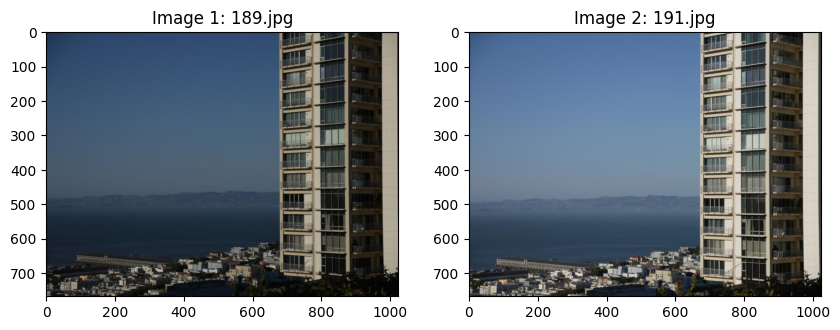

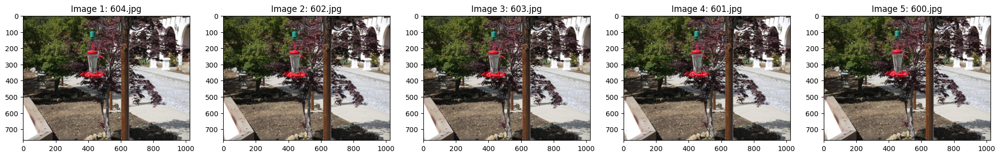

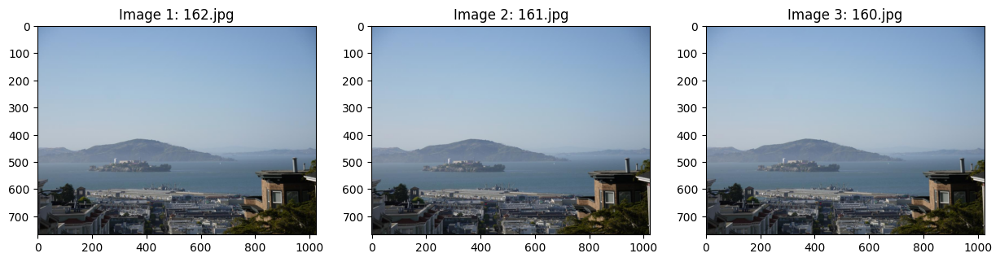

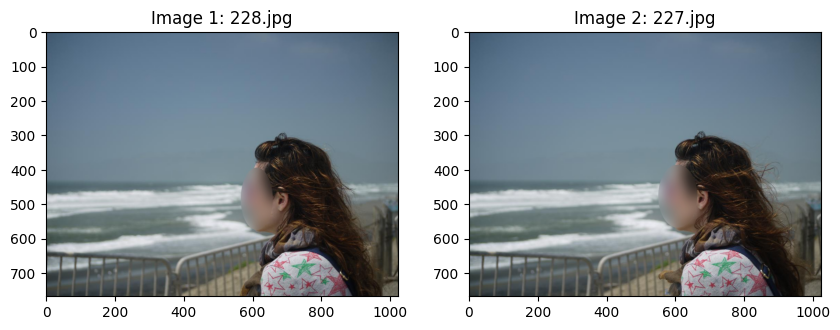

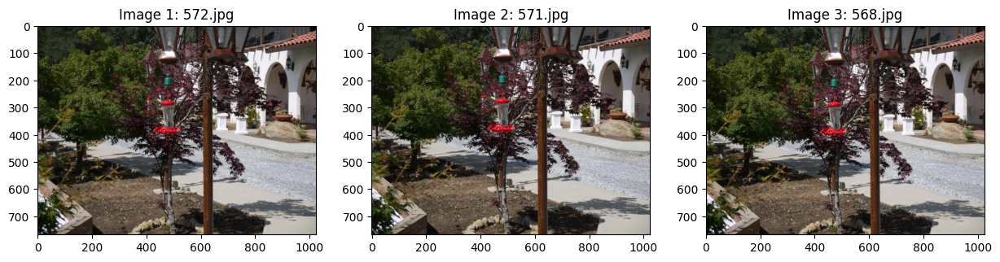

...

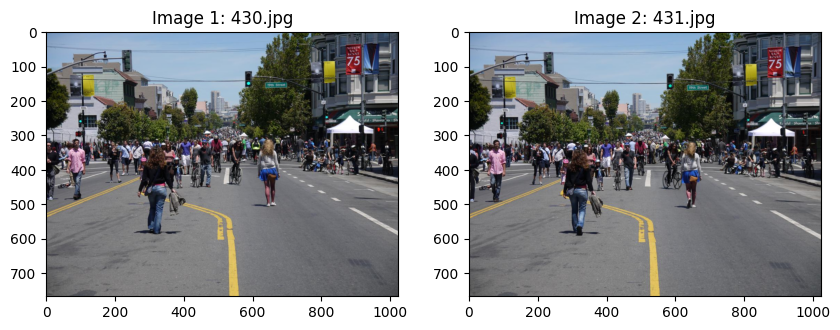

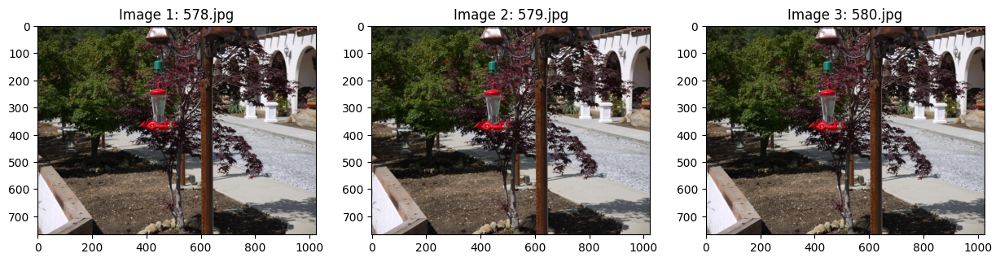

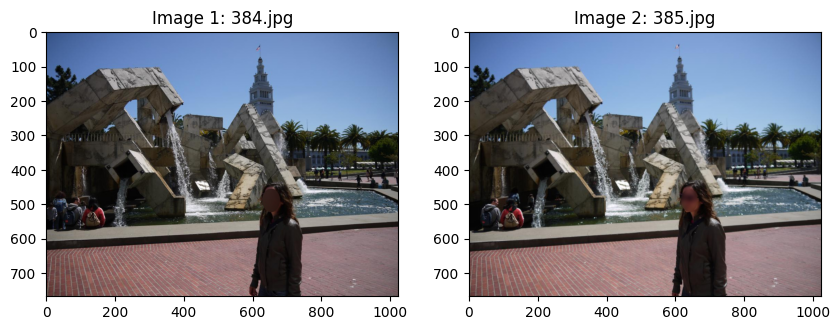

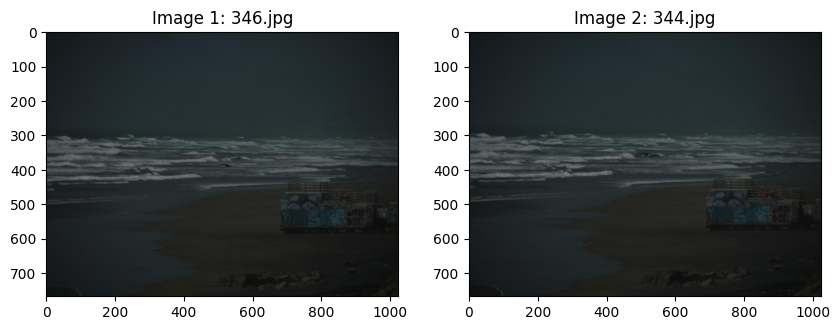

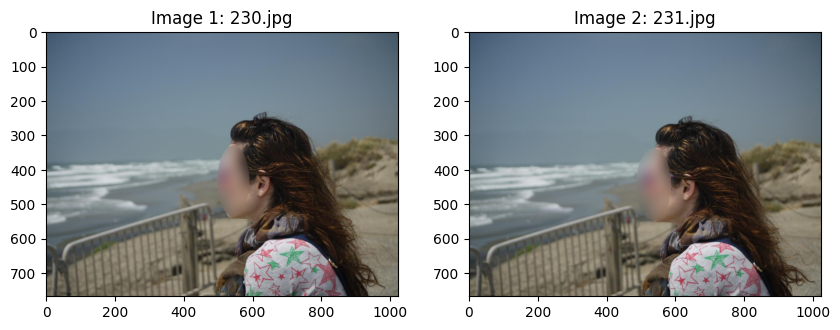

Found 52 groups of duplicate images


In [5]:
if __name__ == "__main__":
    folder_path = "../California/photos"
    duplicate_pairs, unique_images_count, duplicate_images_count = find_duplicates(folder_path)

    print(f"Total number of unique images: {unique_images_count}")
    print(f"Total number of duplicate images: {duplicate_images_count}")

    if duplicate_pairs:
        display_all_duplicate_images(duplicate_pairs)
    else:
        print("No duplicate images found.")
